In [1]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
from matplotlib import animation
from IPython.display import Image
import matplotlib.patheffects as patheffects

In [25]:
def hexlattice_gen(n, a):
    x = np.arange(-n, n, a)
    y = np.arange(-n, n, np.sqrt(3)/2 * a)
    X, Y = np.meshgrid(x, y)
    X[1::2, :] += a / 2  
    
    points = np.vstack([X.ravel(), Y.ravel()]).T
    sentrum_points = []
    for i in range(X.shape[0]):
        row_x = X[i]
        row_y = Y[i]
        offset = 0 if i % 2 == 0 else 1
        for j in range(offset, X.shape[1], 3):
            sentrum_points.append([row_x[j], row_y[j]])
    sentrum_points = np.array(sentrum_points)
    center_point = sentrum_points[np.argmin(np.linalg.norm(sentrum_points, axis=1))]
    points -= center_point
    sentrum_points -= center_point
    filtered_points = remove_centers(points, sentrum_points)
    return filtered_points, sentrum_points

def remove_centers(points, sentrum_points):
    mask = np.ones(len(points), dtype=bool)
    for sp in sentrum_points:
        mask &= ~np.all(points == sp, axis=1)
    return points[mask]

def rot_lattice(points, theta): 
    theta_rad = np.radians(theta)
    rotation_matrix = np.array([[np.cos(theta_rad), -np.sin(theta_rad)],
                                 [np.sin(theta_rad),  np.cos(theta_rad)]])
    rotated_points = points @ rotation_matrix.T
    return rotated_points

def draw_hexagons(ax, sentrum_points_rotated, sentrum_points_original, a, color, alpha, linewidth):
    for (cx, cy), (cx0, cy0) in zip(sentrum_points_rotated, sentrum_points_original):
        v0 = np.array([cx0, cy0, 0])
        v1 = np.array([cx, cy, 0])
        det = np.cross(v0, v1)[2]
        dot = np.dot(v0, v1)
        delta_phi = np.degrees(np.arctan2(det, dot))
        orientation_rad = np.radians(30 + delta_phi)
        hexagon = patches.RegularPolygon(
            (cx, cy), numVertices=6, radius=a, orientation=orientation_rad,
            facecolor='none', edgecolor=color, alpha=alpha, linewidth=linewidth)
        ax.add_patch(hexagon)

def plot_a2_line(theta, a, color, i, variant, marker, show_stacking = False, ax=None, n=None): 
    if show_stacking: variant = 'AA' 
    if variant == 'AB': a = a / 2 
    if theta == 0: a2 = a 
    else: a2 = a / (2 * np.sin(np.radians(theta) / 2)) * np.cos(np.pi/6) 
    x = np.linspace(0, a2, 300) 
    y = np.zeros_like(x) 
    label = fr'$a_{{{i},\mathrm{{{variant}}}}} = {a2:.3f}\cdot a$' 
    if marker and variant == 'AA': 
        x = np.linspace(0, a2, 300) 
        y = np.zeros_like(x) 
        plt.plot(x, y, '-', color = color, label = label) 
        plt.plot(a2, 0, 'o', color = color) 
        if show_stacking: 
            path_effects = [patheffects.withStroke(linewidth=3, foreground='black', capstyle="round")] 
            radius = a2/4 
            circle = plt.Circle((a2, 0), radius=radius, color='Black', fill=False) 
            ax.annotate("AA", xy=(a2, 0 + radius*0.3), fontsize=n/2, color='white',
                        xycoords='data', ha='center', va='bottom',
                        path_effects=path_effects)
            plt.gca().add_patch(circle) 
    if show_stacking: variant = 'AB' ; a2 = a2/2 ; label = fr'$a_{{{i},\mathrm{{{variant}}}}} = {a2:.3f}\cdot a$' 
    if marker and variant == 'AB': 
        a2 = a2 / np.cos(np.pi/6) 
        x = np.linspace(0, a2, 300) 
        y = np.zeros_like(x) 
        points = np.stack([x, y], axis=-1) 
        rot_vec = rot_lattice(points, 30) 
        plt.plot(rot_vec[:, 0], rot_vec[:, 1], '-', color = color, label = label) 
        plt.plot(rot_vec[-1, 0], rot_vec[-1, 1], 'o', color = color) 
        if show_stacking: 
            circle = plt.Circle((rot_vec[-1, 0], rot_vec[-1, 1]), radius=radius, color='Black', fill=False)
            ax.annotate("AB", xy=(rot_vec[-1, 0], rot_vec[-1, 1] + radius*0.3), fontsize=n/2, color='white',
                        xycoords='data', ha='center', va='bottom',
                        path_effects=path_effects) 
            plt.gca().add_patch(circle) 
    # else: plt.plot([], [], '-', color=color, label=label) 
    plt.legend(loc='upper right')



def plot_mult_hexlattice(a, layers, alpha, theta_max, n = 10, marker = True, 
                         variant = 'AA', show_stacking = False):
    colors = ['black', 'red', 'green', 'blue', 'orange']
    fig, ax = plt.subplots(figsize=(6, 6))

    for i in range(layers):
        points, sentrum_points_orig = hexlattice_gen(n, a)
        layer_theta = theta_max * i
        points_rotated = rot_lattice(points, layer_theta)
        sentrum_points_rotated = rot_lattice(sentrum_points_orig, layer_theta)
        if i != 0: label = fr'$\theta_{{{i}}} = {layer_theta:.1f}^\circ$'
        else: label = ''
        if i != 0: plot_a2_line(layer_theta, a*2, colors[i % len(colors)], i, variant, marker, show_stacking, ax, n)
        draw_hexagons(ax, sentrum_points_rotated, sentrum_points_orig, a,
                      color=colors[i % len(colors)], alpha=alpha,
                      linewidth=20/n)
        ax.scatter(points_rotated[:, 0], points_rotated[:, 1],
                   s=25/n, color=colors[i % len(colors)], alpha=alpha,
                   label=label)

    ax.set_aspect('equal')
    plt.axis('off')
    plt.legend(loc='upper right')
    plt.savefig('moire_same_a.png', dpi=600, bbox_inches='tight', transparent=True)
    plt.show()

def plot_hexlattice_gif(a = 1.0, layers = 3, alpha = 0.6, theta_max = 30, n = 10, frames = 36, 
                        filename = 'hex_rotation.gif', variant = 'AA', marker = True):
    fig, ax = plt.subplots(figsize=(6, 6))

    base_points, _ = hexlattice_gen(n, a)
    max_extent = np.max(np.abs(base_points)) + a * 2
    ax.set_xlim(-max_extent, max_extent)
    ax.set_ylim(-max_extent, max_extent)

    def update(frame):
        ax.clear()
        ax.set_xlim(-max_extent, max_extent)
        ax.set_ylim(-max_extent, max_extent)
        ax.set_aspect('equal')
        ax.axis('off')

        colors = ['black', 'red', 'green', 'blue', 'orange']
        theta = frame / (frames - 1) * theta_max
        for i in range(layers):
            points, sentrum_points = hexlattice_gen(n, a)
            points = rot_lattice(points, theta * i)
            sentrum_points_orig = sentrum_points.copy()
            sentrum_points = rot_lattice(sentrum_points, theta * i)
            if i != 0: plot_a2_line(theta * i, a*2, colors[i % len(colors)], i, variant, marker)
            draw_hexagons(ax, sentrum_points, sentrum_points_orig, a, colors[i % len(colors)], alpha=alpha, linewidth=20/n)
            ax.scatter(points[:, 0], points[:, 1], s=25/n, color=colors[i % len(colors)], alpha=alpha)
        ax.set_title(f'Rotation Angle from original axis: {theta:.1f}°')
    anim = animation.FuncAnimation(fig, update, frames=frames, interval=100)
    anim.save(filename, writer='pillow')
    plt.close(fig)

# For valying a:

def plot_a2_line_diff_a(theta, a_arr, color, i, variant = 'AA', marker = True):
    theta_rad = np.deg2rad(theta)
    a_ref = np.mean(a_arr)
    delta = (a_arr - a_ref) / a_ref
    epsilon = 1e-6
    denom = np.sqrt(delta**2 + theta_rad**2)
    denom = np.where(denom == 0, epsilon, denom)
    a_moire = a_ref / denom
    if variant == 'AB': 
        a_moire = a_moire / 2
        a_moire_proj = a_moire
    else: a_moire_proj = a_moire * np.cos(np.pi / 6)
    label = fr'$a_{{M,\mathrm{{{variant}}}}} = {a_moire_proj[i]:.3f}\cdot a$'
    if marker:
        x = np.linspace(0, a_moire_proj[i], 300)
        y = np.zeros_like(x)
        points = np.stack([x, y], axis=-1)
        rot_vec = rot_lattice(points, 0)
        if variant == 'AA': 
            rot_vec = rot_lattice(points, 30)
        plt.plot(rot_vec[:, 0], rot_vec[:, 1], '-', color = color, label = label)
        plt.plot(rot_vec[-1, 0], rot_vec[-1, 1], 'o', color = color)
    else:
        plt.plot([], [], '-', color=color, label=label)
    plt.legend(loc='upper right')

def plot_mult_hexlattice_diff_a(a_arr, n, alpha, theta, variant, marker = True):
    layers = len(a_arr)
    colors = ['black', 'red', 'green', 'blue', 'orange']
    fig, ax = plt.subplots(figsize=(6, 6))
    for i in range(layers):
        a = a_arr[i]
        points, sentrum_points_orig = hexlattice_gen(n, a)
        layer_theta = theta * i
        points_rotated = rot_lattice(points, layer_theta)
        sentrum_points_rotated = rot_lattice(sentrum_points_orig, layer_theta)
        if i != 0: label = fr'$\theta_{{{i}}} = {layer_theta:.1f}^\circ$'
        else: label = ''
        if i != 0: plot_a2_line_diff_a(layer_theta, a_arr, colors[i % len(colors)], i, variant, marker)
        draw_hexagons(ax, sentrum_points_rotated, sentrum_points_orig, a,
                      color=colors[i % len(colors)], alpha=alpha,
                      linewidth=20/n)
        ax.scatter(points_rotated[:, 0], points_rotated[:, 1],
                   s=25/n, color=colors[i % len(colors)], alpha=alpha,
                   label=label)
    ax.set_aspect('equal')
    plt.axis('off')
    plt.legend(loc='upper right')
    plt.savefig('moire_same_a.png', dpi=600, bbox_inches='tight', transparent=True)
    plt.show()

def plot_hexlattice_gif_variable_a2(a = 1.0, a2_max = 1.2, alpha = 0.6, theta = 0.0, n = 40, 
                                    frames = 36, filename = 'hex_variable_a2.gif', variant = 'AA', marker = True):
    layers=2
    fig, ax = plt.subplots(figsize=(6, 6))
    base_points, _ = hexlattice_gen(n, a)
    max_extent = np.max(np.abs(base_points)) + a2_max * 2
    ax.set_xlim(-max_extent, max_extent)
    ax.set_ylim(-max_extent, max_extent)

    def update(frame):
        ax.clear()
        ax.set_xlim(-max_extent, max_extent)
        ax.set_ylim(-max_extent, max_extent)
        ax.set_aspect('equal')
        ax.axis('off')
        colors = ['black', 'red', 'green', 'blue', 'orange'] 
        a2 = a + (a2_max - a) * frame / (frames - 1)
        a_arr = np.array([a, a2])

        for i in range(layers):
            a_layer = a_arr[i] if i < len(a_arr) else a
            points, sentrum_points = hexlattice_gen(n, a_layer)
            points = rot_lattice(points, theta * i)
            sentrum_points_orig = sentrum_points.copy()
            sentrum_points = rot_lattice(sentrum_points, theta * i)

            if i != 0: plot_a2_line_diff_a(theta * i, a_arr, colors[i % len(colors)], i, variant, marker)
            draw_hexagons(ax, sentrum_points, sentrum_points_orig, a_layer,
                          colors[i % len(colors)], alpha=alpha, linewidth=20/n)
            ax.scatter(points[:, 0], points[:, 1], s=25/n,
                       color=colors[i % len(colors)], alpha=alpha)
        ax.set_title(fr'$a_2 = {a2:.3f}\cdot a,\ \theta = {theta:.1f}^\circ$')

    anim = animation.FuncAnimation(fig, update, frames=frames, interval=100)
    anim.save(filename, writer='pillow')
    plt.close(fig)

### Moiré Pattern Visualization

---
#### Parameters
- **`a`** - Distance between centers of neighboring hexagons in the lattice  
- **`layers`** - Number of hexagonal lattices stacked  
- **`alpha`** - Transparency of each lattice layer  
- **`theta_max`** - Maximum rotation between layers  
- **`n`** - Number of hexagons in the lattice, structured as $ \langle n, n \rangle $  
- **`marker`** - Choose `True` or `False` if you want to see the small angle approximation of the Moirè lattice constant
- **`variant`** - Choose `'AA'` or `'AB'` to visualize different stacking regions
- **`show_stacking`** - Choose `True` or `False` to better visualize the `AA` and `AB` regions

---

Adjust `theta_max` and `variant` to explore how subtle angular shifts produce new interference patterns

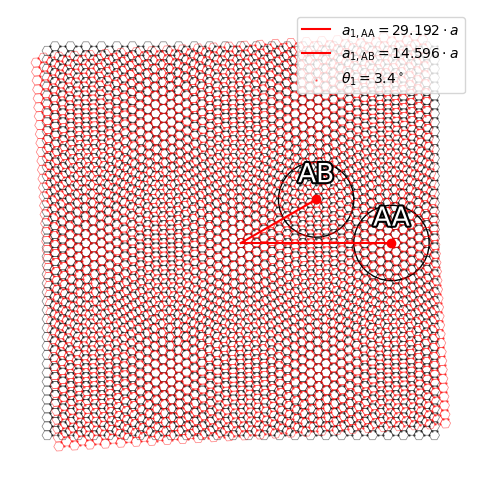

In [22]:
plot_mult_hexlattice(a = 1.0, layers = 2, alpha = 0.5, theta_max = 3.4, n = 38, marker = True,
                     variant = 'AB', show_stacking = True)

The resulting moirè superlattice gives rise to spatially varying stacking configurations, most notably regions of AA and AB stacking as seen in above. In AA regions, atoms from both layers are directly aligned, leading to high local symmetry and often enhanced interlayer coupling. In contrast, AB regions exhibit staggered alignment, where atoms in one layer sit above the centers of hexagons in the other, resulting in reduced symmetry and distinct electronic properties.

This can also be animated to show how the **new lattice constant** changes with the rotation angle $ \theta $.

By stacking rotated hexagonal lattices and observing the resulting interference patterns, we can visualize how $ \text{a}_{i,\mathrm{AA}} $ or $ \text{a}_{i,\mathrm{AB}} $ evolves as a function of $ \theta $.

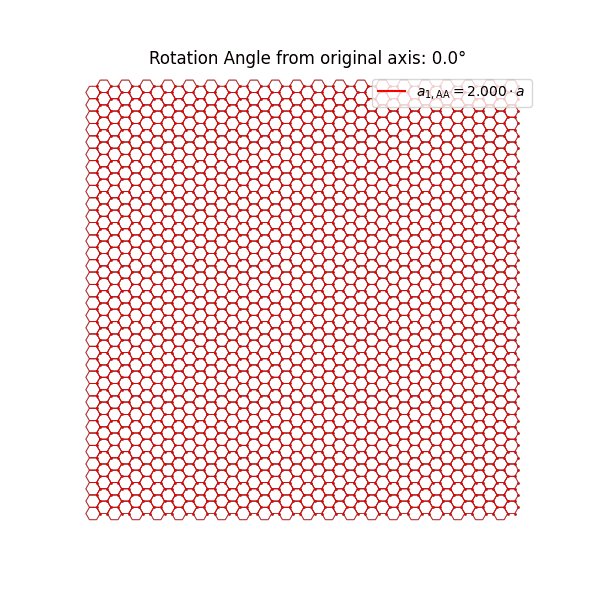

In [4]:
plot_hexlattice_gif(layers=2, theta_max=12, n=30, frames=36, filename='hex_rotation.gif', variant='AA', marker = False)
Image(filename='hex_rotation.gif')

As the relative rotation between the two lattices increases, the lattice parameter of the resulting Moiré pattern decreases continuously. When the rotation angle approaches $30^\circ$, corresponding to half the periodic angle, the Moiré length scale converges toward that of the underlying atomic lattices.

Around $30^\circ$, the Moiré pattern becomes indistinct, and instead, highly complex local structures emerge. This transition occurs within a range of approximately $\pm8 ^\circ$ around $30^\circ$, i.e., from $22^\circ$ to $38^\circ$.

At exactly $30^\circ$, a dodecagonal quasicrystalline pattern forms, characterized by twelvefold rotational symmetry and lacking translational periodicity.

Beyond $38^\circ$, the Moiré pattern reappears, gradually evolving from smaller to larger lattice constants as the rotation angle continues to increase:

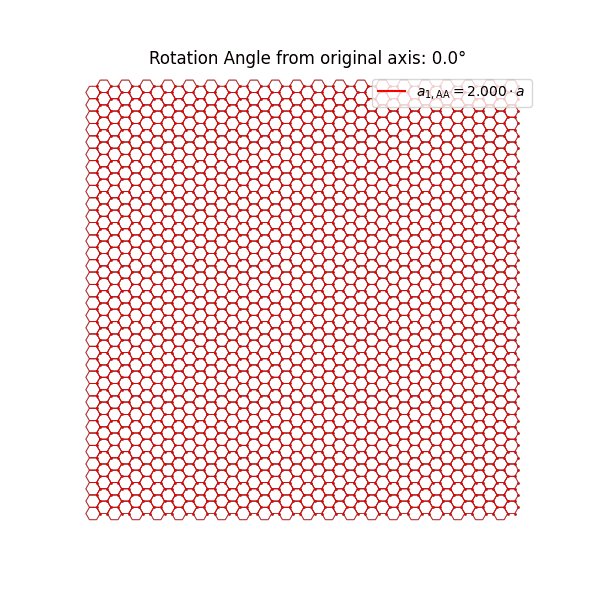

In [5]:
plot_hexlattice_gif(layers = 2, theta_max = 50, n = 30, frames = 72, filename = 'hex_rotation_dodecahedron.gif', 
                    variant = 'AA', marker = False)
Image(filename='hex_rotation_dodecahedron.gif')

We could also add multiple layers rotating at different speeds around the original axis

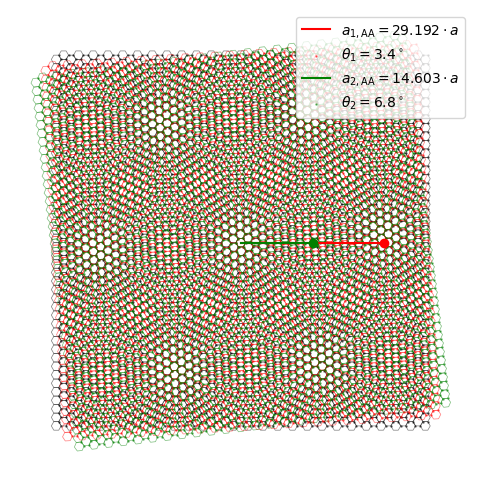

In [24]:
plot_mult_hexlattice(a = 1.0, layers = 3, alpha = 0.5, theta_max = 3.4, n = 38, 
                     marker = True, variant = 'AA')
# plot_hexlattice_gif(layers=3, theta_max=12, n=30, frames=36, 
#                     filename='hex_rotation.gif', variant='AA', marker = False)
# Image(filename='hex_rotation.gif')

We observe the emergence of subregions where the periodicity of the second layer rotated by $2\cdot\theta$, leads to features appearing twice as frequently. This results in AAB-type stacking at the midpoint between the AAA regions, where all three layers align. The structure is generated by stacking three layers, each rotated by $\theta \cdot i$, and we see that introducing additional layers further increases the number of distinct subregions. Moreover, by breaking the condition that each layer is rotated by an integer multiple of $\theta$, we introduce new periodicities and even more intricate Moiré patterns, with longer superlattice constants corresponding to the scale at which all layers realign.


For twisted bilayer graphene ($\text{a} \approx 2.467~\text{\AA}$) at the magic angle $\theta \approx 1.1^\circ$, we get a moiré lattice constant around $11 ~nm$ as shown below.
This large emergent length scale is what enables flat bands and correlated electronic phases in TBG.

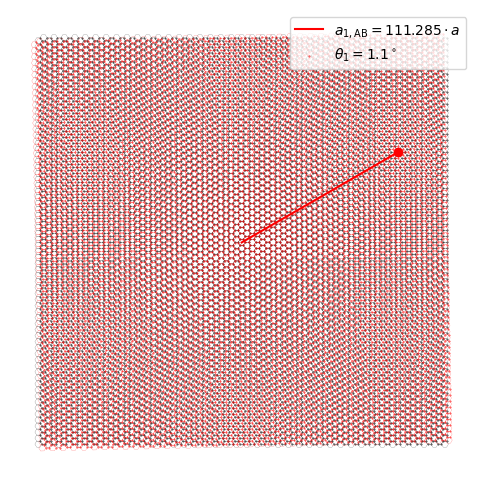

In [7]:
plot_mult_hexlattice(a = 2.467, layers = 2, alpha = 0.8, theta_max = 1.1, n = 145, marker = True, variant = 'AB')

#### Moiré patterns also emerge when two lattices with similar geometry but slightly different lattice constants are overlaid

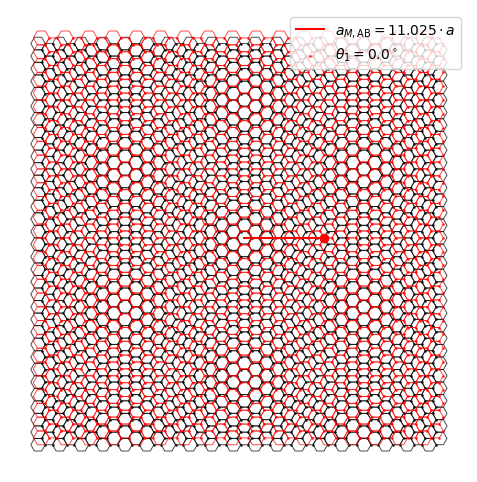

In [18]:
a_arr = np.array([1.0, 1.1])
plot_mult_hexlattice_diff_a(a_arr, n = 28, alpha = 0.7, theta = 0, variant='AB', marker = True)

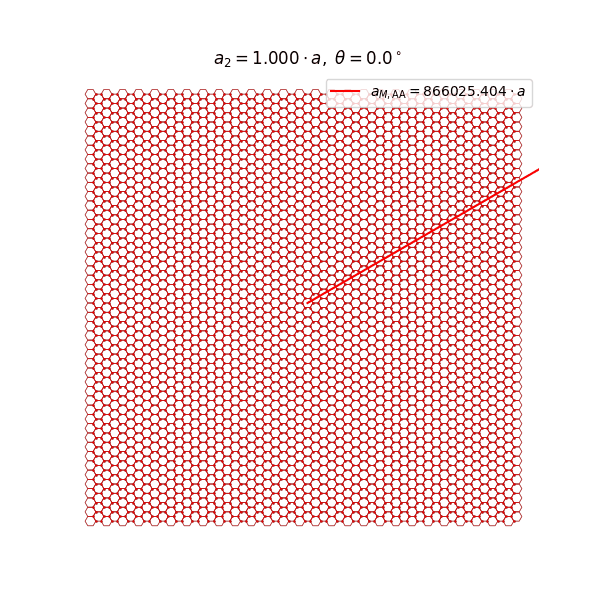

In [9]:
plot_hexlattice_gif_variable_a2(a2_max = 1.2, filename = 'hex_variable_a2.gif', 
                                variant = 'AA', marker = True)
Image(filename='hex_variable_a2.gif')

By keeping the rotational shift angle $\theta$ constant between two layers and varying the lattice constant mismatch, we can further tailor the resulting Moiré pattern, as illustrated below.


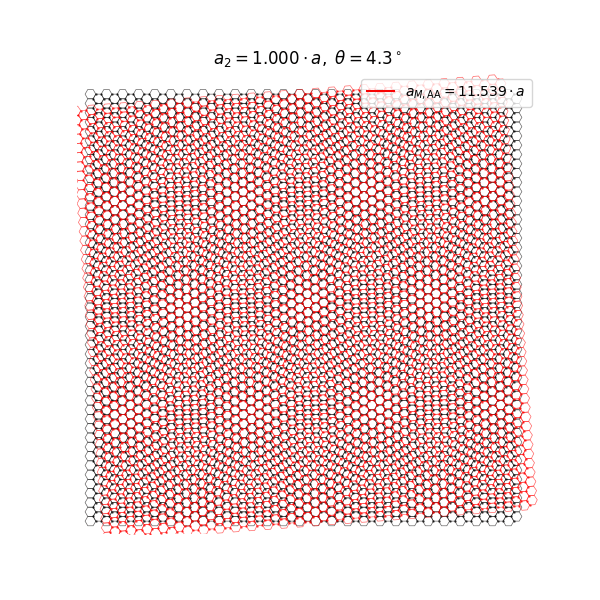

In [19]:
plot_hexlattice_gif_variable_a2(a2_max = 1.2, theta = 4.3, filename = 'hex_variable_a2_theta.gif', 
                                variant='AA', marker=False)
Image(filename='hex_variable_a2_theta.gif')